In [6]:
!conda install -y -c conda-forge unzip

Channels:
 - conda-forge
 - https://aws-ml-conda.s3.us-west-2.amazonaws.com
 - nvidia
Platform: linux-64
Solving environment: done


==> WARNING: A newer version of conda exists. <==
    current version: 23.11.0
    latest version: 24.3.0

Please update conda by running

    $ conda update -n base -c conda-forge conda



# All requested packages already installed.



In [9]:
!unzip -q gesture_2.v4i.yolov9.zip 

In [2]:
!nvidia-smi

Fri Apr 19 00:53:07 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:1E.0 Off |                    0 |
| N/A   29C    P0              26W /  70W |      2MiB / 15360MiB |      5%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
import os
HOME = os.getcwd()
print(HOME)

/root/DLCNN_Assignment_3/yolov9


# Clone YOLOV9 Repository

In [12]:
!git clone https://github.com/SkalskiP/yolov9.git
%cd yolov9
!pip install -r requirements.txt -q

Cloning into 'yolov9'...
remote: Enumerating objects: 325, done.
remote: Total 325 (delta 0), reused 0 (delta 0), pack-reused 325
Receiving objects: 100% (325/325), 2.25 MiB | 16.45 MiB/s, done.
Resolving deltas: 100% (164/164), done.
Updating files: 100% (100/100), done.
/root/DLCNN_Assignment_3/yolov9


In [4]:
!pip install -r requirements.txt -q

In [2]:
%cd yolov9

/root/DLCNN_Assignment_3/yolov9


Get the weights of yolov9 large version  to initialize the network

In [13]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt

In [14]:
!ls -la {HOME}/weights

total 136940
drwxr-xr-x 2 root root      6144 Apr 16 09:32 .
drwxr-xr-x 6 root root      6144 Apr 16 09:32 ..
-rw-r--r-- 1 root root 140217688 Feb 18 12:36 yolov9-e.pt


In [5]:
!ls

README.md      export.py   requirements.txt  train_dual.py    val_triple.py
benchmarks.py  figure	   runs		     train_triple.py  weights
classify       hubconf.py  scripts	     utils
data	       models	   segment	     val.py
detect.py      panoptic    train.py	     val_dual.py


# Train YOLOV9

This command executes a Python script that trains YOLOV9 using the GPU:

* --workers 8: Specifies the number of worker processes to use during training
* --device 0: Specifies the GPU device to use for training. In this case, 0 indicates the first and only GPU device.
* --img 640: Sets the input image size for training to 640x640 pixels.
* --batch 6: Defines the batch size for training, which is set to 6 images per batch.
* --epochs 300: Specifies the number of epochs (training iterations) to run during training, set to 300 epochs.
* --data ./data/data_assignment_2/data.yaml: Points to the YAML file containing the dataset configuration, including paths to training, testing, and validation images, classes, etc.
* --cfg ./models/detect/yolov9-c.yaml: Specifies the YOLOv9 model configuration file (yolov9-c.yaml), which defines the architecture and parameters of the YOLOv9 model.
* --weights ./weights/yolov9-c.pt: Specifies the initial weights file for the model. In this case, yolov9-c.pt contains pre-trained weights to perform transfer learning
* --name assignment_2_v1: Sets a name for the training session, which can be used to identify and manage different training runs or versions.
* --hyp ./data/hyps/hyp.scratch-high.yaml: Specifies the hyperparameters file (hyp.scratch-high.yaml) containing tuning parameters for the training process.
* --min-items 0: Sets a minimum number of items required for a class to be included in training. In this case, 0 means all classes are included regardless of item count.
* --close-mosaic 15: Defines a parameter related to data augmentation, specifically for the close-mosaic augmentation method.

In [ ]:
%cd {HOME}/yolov9

!python train_dual.py \
--workers 8 --device 0 --img 640 --batch 8 --epochs 70 \
--data ./data/project/data.yaml --cfg ./models/detect/yolov9-e.yaml\
--weights ./weights/yolov9-e.pt --name assignment_3_yolov9_e_v1 --hyp ./data/hyps/hyp.scratch-high.yaml --min-items 0 --close-mosaic 15

/root/DLCNN_Assignment_3/yolov9
train_dual: weights=./weights/yolov9-e.pt, cfg=./models/detect/yolov9-e.yaml, data=./data/project/data.yaml, hyp=./data/hyps/hyp.scratch-high.yaml, epochs=70, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=0, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=assignment_3_yolov9_e_v1, exist_ok=False, quad=False, cos_lr=False, flat_cos_lr=False, fixed_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, min_items=0, close_mosaic=15, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=7.5, cls=0.5, cls_pw=1.

Due to session expired we have to re start the training process from the best weights obtained previously

In [ ]:
%cd {HOME}/yolov9

!python train_dual.py \
--workers 8 --device 0 --img 640 --batch 8 --epochs 174 \
--data ./data/project/data.yaml --cfg ./models/detect/yolov9-e.yaml\
--weights ./runs/train/assignment_3_yolov9_e_v12/weights/best.pt --name assignment_3_yolov9_e_v1 --hyp ./data/hyps/hyp.scratch-high.yaml --min-items 0 --close-mosaic 15

/root/DLCNN_Assignment_3/yolov9
train_dual: weights=./runs/train/assignment_3_yolov9_e_v12/weights/best.pt, cfg=./models/detect/yolov9-e.yaml, data=./data/project/data.yaml, hyp=./data/hyps/hyp.scratch-high.yaml, epochs=174, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=0, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=assignment_3_yolov9_e_v1, exist_ok=False, quad=False, cos_lr=False, flat_cos_lr=False, fixed_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, min_items=0, close_mosaic=15, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_l

In [8]:
%cd {HOME}/yolov9

!python train_dual.py \
--workers 8 --device 0 --img 640 --batch 8 --epochs 11 \
--data ./data/project/data.yaml --cfg ./models/detect/yolov9-e.yaml\
--weights ./runs/train/assignment_3_yolov9_e_v13/weights/best.pt --name assignment_3_yolov9_e_v1 --hyp ./data/hyps/hyp.scratch-high.yaml --min-items 0 --close-mosaic 15

[Errno 2] No such file or directory: '/root/DLCNN_Assignment_3/yolov9/yolov9'
/root/DLCNN_Assignment_3/yolov9
train_dual: weights=./runs/train/assignment_3_yolov9_e_v13/weights/best.pt, cfg=./models/detect/yolov9-e.yaml, data=./data/project/data.yaml, hyp=./data/hyps/hyp.scratch-high.yaml, epochs=11, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=0, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=assignment_3_yolov9_e_v1, exist_ok=False, quad=False, cos_lr=False, flat_cos_lr=False, fixed_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, min_items=0, close_mosaic=15, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.93

# Evaluate the model with Testing data

The model has been trained and the best weights are passed to the network, for this evaluation the iou threshold was defined as 0.70 and the confidence score 0.8. Both parameters determine when a detected object is considered valid based on the confidence score output by the model and the iou based on the bounding boxes predicted by the model.

In [4]:
cd yolov9

/root/yolov9


In [5]:
# evaluate model with the validation set

!python val_dual.py --data ./data/project/data.yaml --img 640 --batch 16 \
--conf 0.001 --iou 0.7 --device 0 --weights ./runs/train/assignment_3_yolov9_e_v14/weights/best.pt --save-json --name assignment_3_yolov9_e_validation_3

val_dual: data=./data/project/data.yaml, weights=['./runs/train/assignment_3_yolov9_e_v14/weights/best.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=True, project=runs/val, name=assignment_3_yolov9_e_validation_3, exist_ok=False, half=False, dnn=False, min_items=0
YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

Fusing layers... 
yolov9-e summary: 1119 layers, 69359120 parameters, 0 gradients, 243.4 GFLOPs
val: Scanning /root/DLCNN_Assignment_3/yolov9/data/project/valid/labels.cache...
                 Class     Images  Instances          P          R      mAP50   Exception in thread Thread-3 (plot_images):
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/opt/conda/lib/python3.10/threading.py", line 953,

In [6]:
# evaluate model with the training set

!python val_dual.py --data ./data/project/data-training.yaml --img 640 --batch 16 \
--conf 0.001 --iou 0.7 --device 0 --weights ./runs/train/assignment_3_yolov9_e_v14/weights/best.pt --save-json --name assignment_3_yolov9_e_training_3

val_dual: data=./data/project/data-training.yaml, weights=['./runs/train/assignment_3_yolov9_e_v14/weights/best.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=True, project=runs/val, name=assignment_3_yolov9_e_training_3, exist_ok=False, half=False, dnn=False, min_items=0
YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

Fusing layers... 
yolov9-e summary: 1119 layers, 69359120 parameters, 0 gradients, 243.4 GFLOPs
val: Scanning /root/DLCNN_Assignment_3/yolov9/data/project/train/labels.cache...
                 Class     Images  Instances          P          R      mAP50   Exception in thread Thread-3 (plot_images):
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/opt/conda/lib/python3.10/threading.py", li

In [7]:
# evaluate model with the testing set

!python val_dual.py --data ./data/project/data-testing.yaml --img 640 --batch 16 \
--conf 0.001 --iou 0.7 --device 0 --weights ./runs/train/assignment_3_yolov9_e_v14/weights/best.pt --save-json --name assignment_3_yolov9_e_testing_3

val_dual: data=./data/project/data-testing.yaml, weights=['./runs/train/assignment_3_yolov9_e_v14/weights/best.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=True, project=runs/val, name=assignment_3_yolov9_e_testing_3, exist_ok=False, half=False, dnn=False, min_items=0
YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

Fusing layers... 
yolov9-e summary: 1119 layers, 69359120 parameters, 0 gradients, 243.4 GFLOPs
val: Scanning /root/DLCNN_Assignment_3/yolov9/data/project/test/labels.cache... 
                 Class     Images  Instances          P          R      mAP50   Exception in thread Thread-3 (plot_images):
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/opt/conda/lib/python3.10/threading.py", line

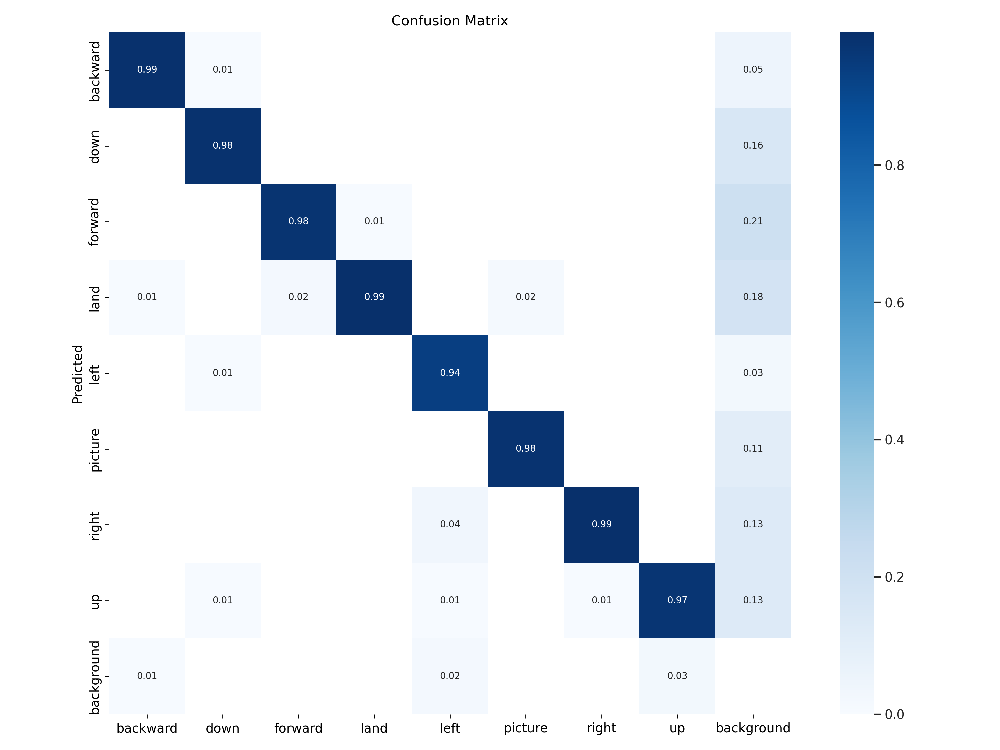

In [15]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/val/assignment_3_yolov9_e_testing_3/confusion_matrix.png", width=1000)

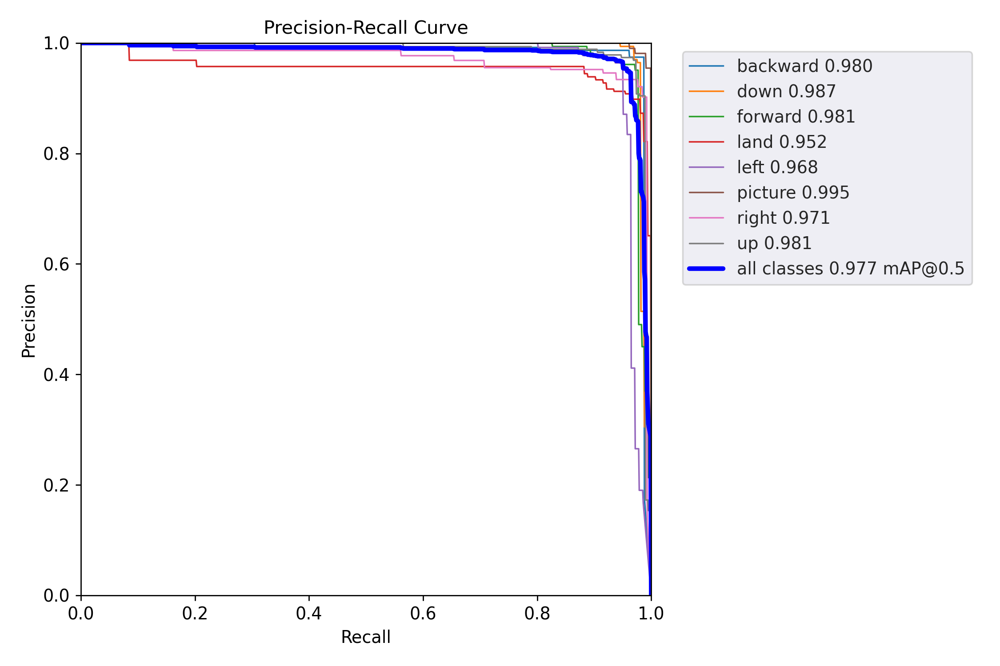

In [16]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/val/assignment_3_yolov9_e_testing_3/PR_curve.png", width=1000)

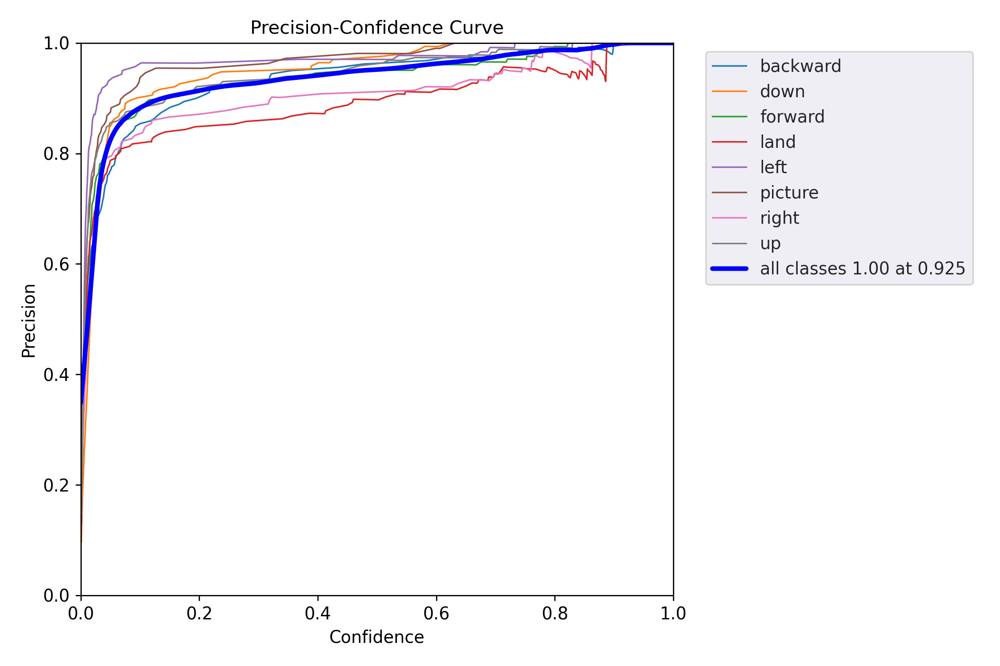

In [17]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/val/assignment_3_yolov9_e_testing_3/P_curve.png", width=1000)

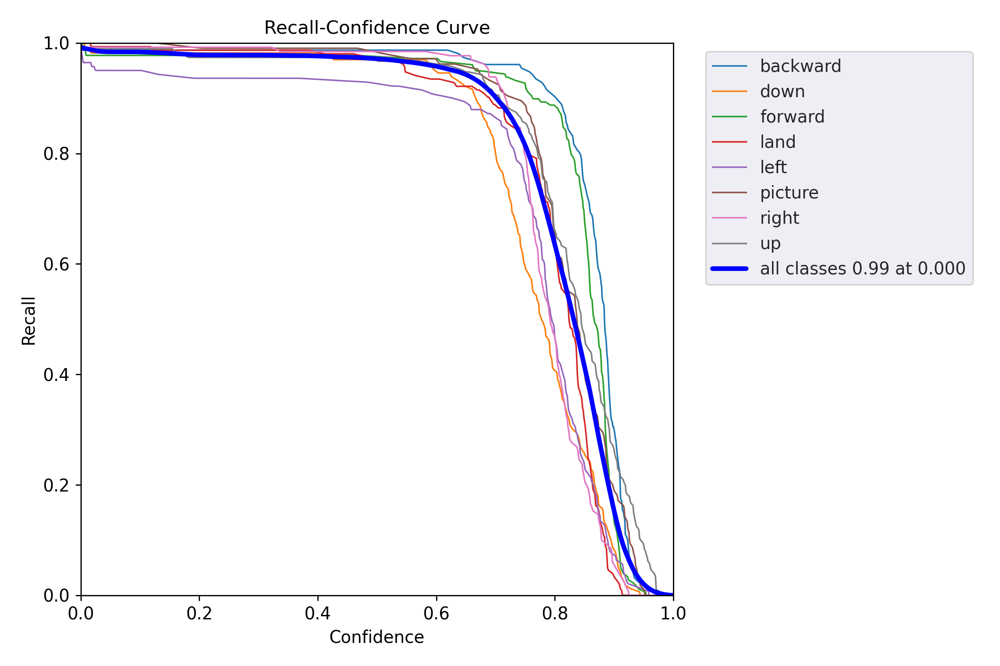

In [18]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/val/assignment_3_yolov9_e_testing_3/R_curve.png", width=1000)

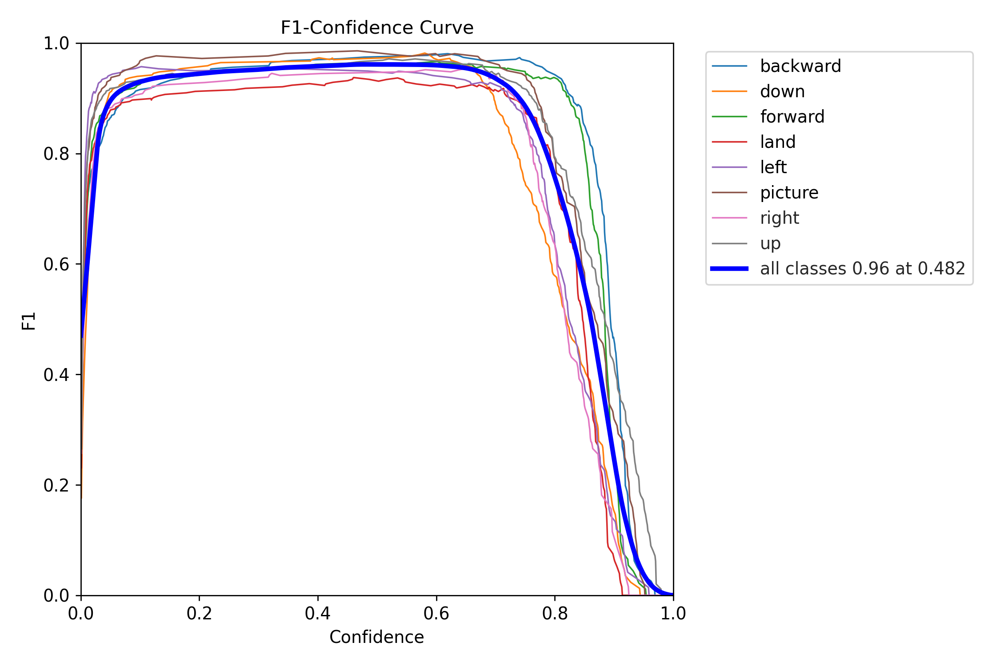

In [19]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/val/assignment_3_yolov9_e_testing_3/F1_curve.png", width=1000)

# Inference using the trained model

In [8]:
# Import necessary libraries
from pathlib import Path  # For handling file paths
import numpy as np  # For numerical operations
import torch  # PyTorch library for deep learning
import cv2  # OpenCV library for image processing
from models.common import DetectMultiBackend  # function to load the model
from utils.general import (Profile, check_img_size, non_max_suppression, scale_boxes)  # General utility functions
from utils.plots import Annotator, colors  # Utility for annotating and plotting images
from utils.torch_utils import select_device  # Utility for selecting PyTorch device
import os  # Operating system operations
import matplotlib.pyplot as plt  # Matplotlib for plotting

Function to load the treined weights

In [9]:
def load_model(weights, device, imgsz):
    # Select PyTorch device
    device = select_device(device)

    # Initialize object detection model
    model = DetectMultiBackend(weights, device=device, dnn=False, fp16=False)
    
    # Get model properties
    stride, names, pt = model.stride, model.names, model.pt
    
    # Check and adjust image size
    imgsz = check_img_size(imgsz, s=stride)  # Check image size against stride
    
    # Warm up the model for inference
    model.warmup(imgsz=(1, 3, *imgsz))  # Warm up the model

    return model, names, pt

This function performs inference using an object detection model on an input image. It preprocesses the image, runs inference, applies non-maximum suppression, processes the predictions, and returns the annotated image with bounding boxes and labels along with the predicted classes and their confidence scores

In [10]:
def inference(im, model, names, line_thickness):
    # Initialize profiles for timing
    dt = (Profile(), Profile(), Profile())
    
    # Prepare image for inference
    im = np.expand_dims(im, 0)  # Add batch dimension
    im = im[..., ::-1].transpose((0, 3, 1, 2))  # Convert BGR to RGB and transpose dimensions
    im0s = im.copy()  # Copy the image for visualization
    im0s = np.squeeze(im0s, 0)  # Remove batch dimension
    im0s = np.transpose(im0s, (1, 2, 0))  # Transpose dimensions for display
    
    # Convert image to PyTorch tensor and preprocess
    with dt[0]:
        im = torch.from_numpy(im.copy()).to(model.device)  # Convert to PyTorch tensor and move to device
        im = im.float()  # Convert to float
        im /= 255  # Normalize to [0, 1]
        if len(im.shape) == 3:
            im = im[None]  # Add batch dimension if necessary
    
    # Perform inference
    with dt[1]:
        pred = model(im, augment=False, visualize=False)  # Get predictions
        pred = pred[0][1]  # Extract relevant predictions
    
    # Apply non-maximum suppression
    with dt[2]:
        pred = non_max_suppression(prediction=pred,
                                   conf_thres=0.70,
                                   iou_thres=0.45,
                                   agnostic=False,
                                   max_det=1000)
    
    # Process predictions
    det = pred[0]  # Get detections
    annotator = Annotator(np.ascontiguousarray(im0s), line_width=line_thickness, font_size=2, example=str(names))  # Initialize annotator
    predicted_classes = []
    if len(det):
        # Rescale boxes from img_size to im0 size
        det[:, :4] = scale_boxes(im.shape[2:], det[:, :4], im0s.shape).round()
        # Write results
        for *xyxy, conf, cls in reversed(det):
            c = int(cls)  # Integer class
            label = f'{c}'  # Class label
            annotator.box_label(xyxy, label, color=colors(c, True))  # Add bounding box and label to image
            predicted_classes.append((names[c], conf.item()))  # Record predicted classes and confidence
    
    # Get annotated image
    im0 = annotator.result()
    
    return predicted_classes, im0  # Return predicted classes and annotated image


This function retrieves the paths of JPG images within a specified folder path. It iterates over the directory tree starting from the given folder path and collects the paths of all files with a '.jpg' extension.

In [11]:

def get_image_paths(folder_path):
    # Initialize an empty list to store the image paths
    image_paths = []
    
    # Traverse through the directory tree using os.walk
    for root, dirs, files in os.walk(folder_path):
        # Iterate through the files in the current directory
        for file in files:
            # Check if the file has a '.jpg' extension (case insensitive)
            if file.endswith(('.jpg')):
                # Append the absolute path of the image file to the image_paths list
                image_paths.append(os.path.join(root, file))
    
    # Return the list of image paths
    return image_paths

This function performs inference on the set of testing images using the trained model, displaying the results for every 10 images.

In [12]:


# Importing libraries
%matplotlib inline
import matplotlib.pyplot as plt
import cv2

# Function to run inference
def run(weights,
        device,
        imgsz,  # inference size (height, width)
        line_thickness=2,
        plot_every=10):  # Change plot_every to 10

    # Load the model and get class names
    model, names, _ = load_model(weights, device, imgsz)
    
    # Get paths of test images
    img_paths = get_image_paths('./data/project/test/images')

    predictions_count = 0  # Initialize the counter

    # Iterate through each image path
    for path in img_paths:
        # Read and resize the image
        image = cv2.imread(path)
        image = cv2.resize(image, imgsz)

        # Perform inference and get predicted classes and annotated image
        predicted_classes, im0 = inference(image, model, names, line_thickness)
        
        # Increment predictions count and check if it's time to plot
        predictions_count += 1
        if predictions_count % plot_every == 0:  # Plot every 10 images
            # Display the annotated image
            plt.imshow(im0)
            plt.title("{0: 'Backward', 1: 'Down', 2: 'Forward', 3: 'Land', 4: 'Left', 5: 'Picture', 6: 'Right', 7: 'Up'}")
            plt.show()
            



YOLOv5 🚀 1e33dbb Python-3.10.13 torch-2.2.0 CUDA:0 (Tesla T4, 14931MiB)

Fusing layers... 
yolov9-e summary: 1119 layers, 69359120 parameters, 0 gradients, 243.4 GFLOPs


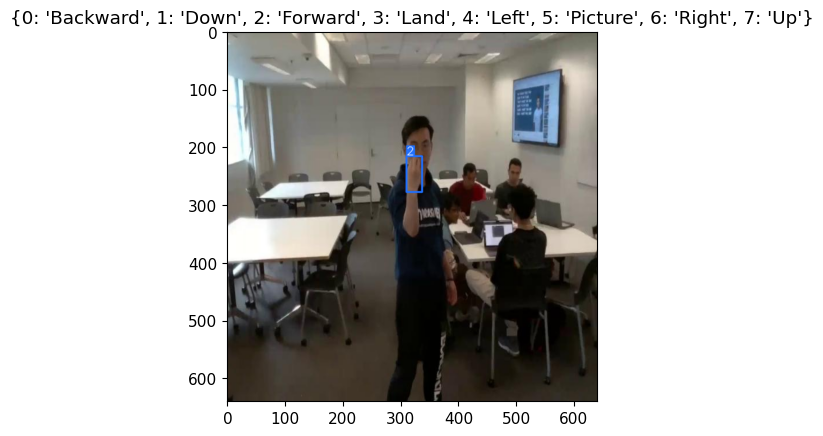

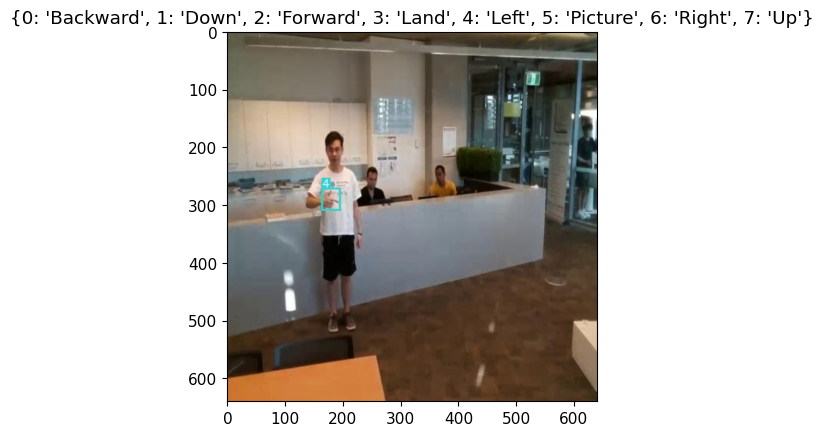

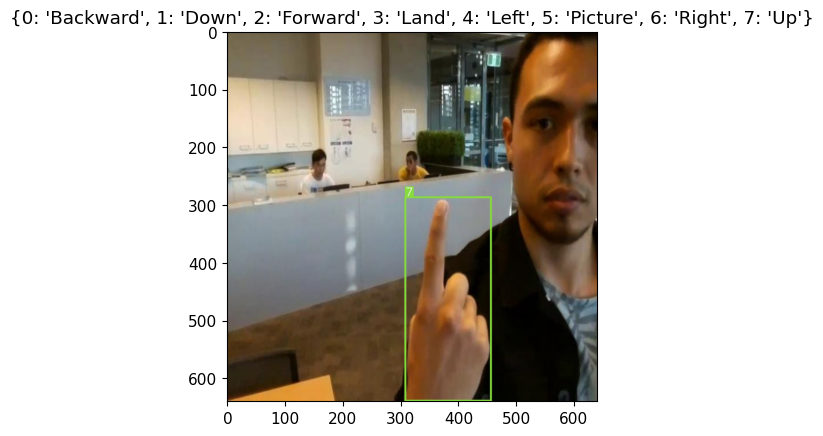

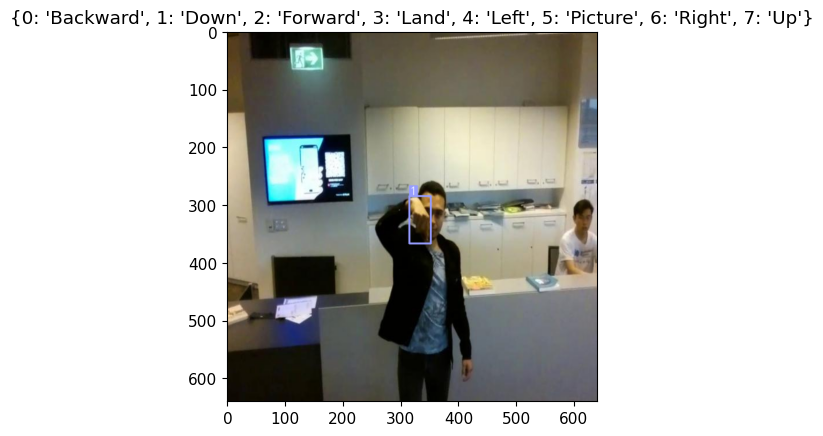

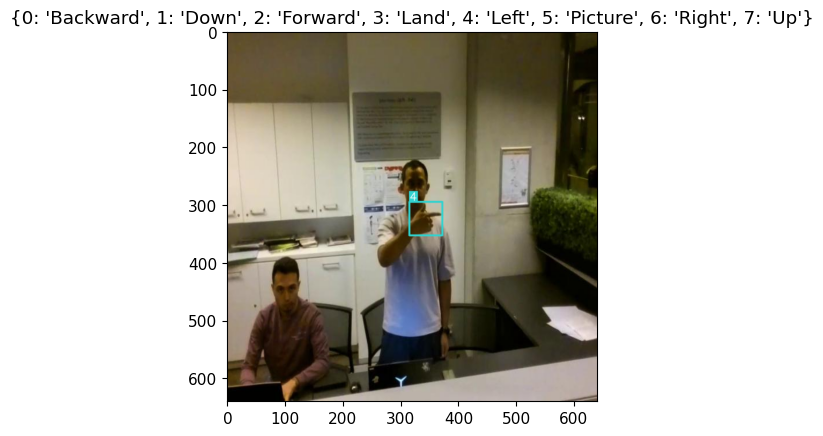

...

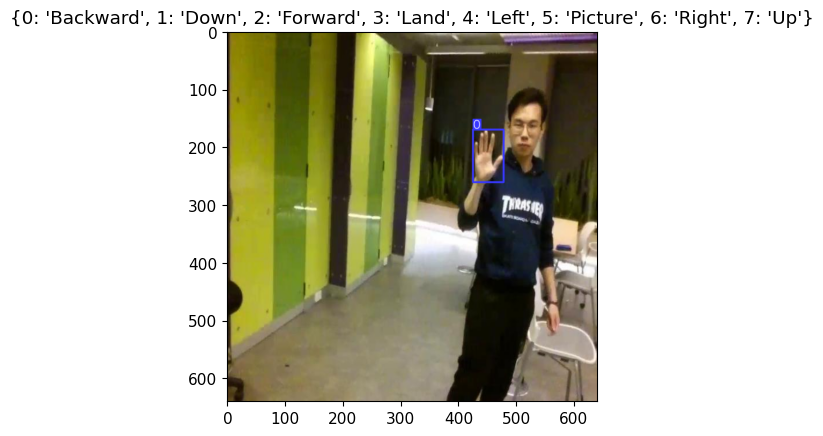

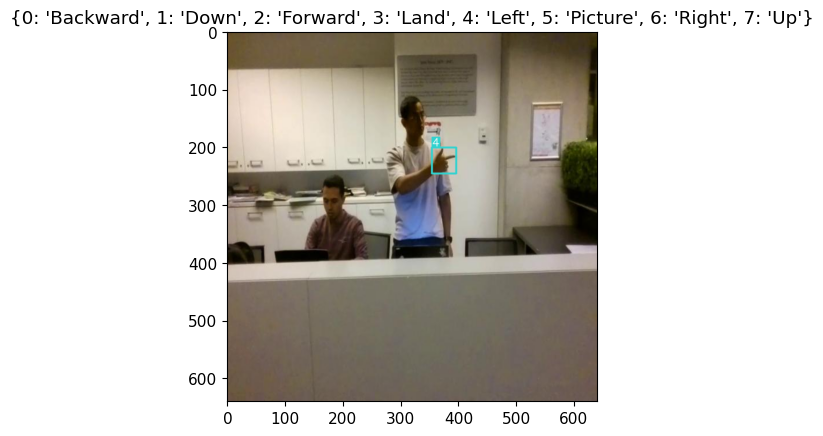

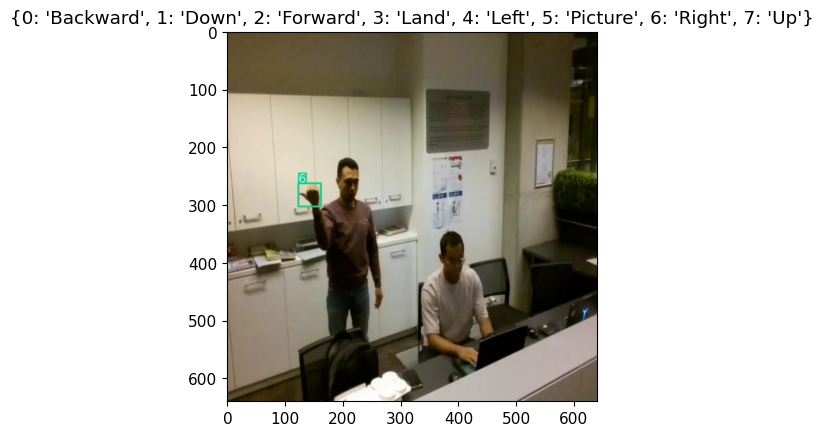

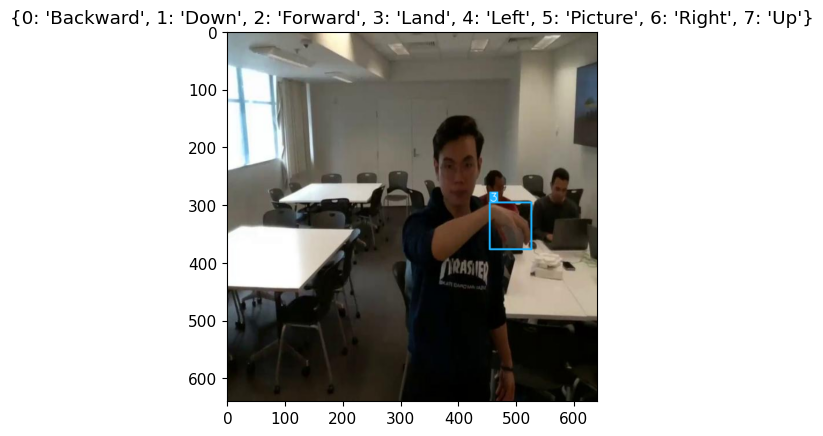

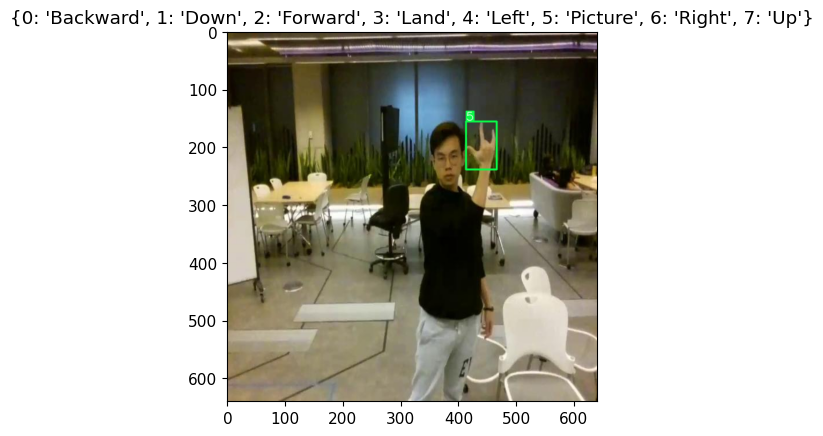

In [13]:
weights = './runs/train/assignment_3_yolov9_e_v14/weights/best.pt'
device = 0 # cuda device
imgsz=(640, 640)
run(weights,device,imgsz)